In [1]:
import pandas as pd
import cv2
import os
import matplotlib.pyplot as plt
import glob
import shutil
from pathlib import Path
import seaborn as sns
import numpy as np
import math

from segment_image import segment_image
from sklearn.cluster import KMeans
import random

In [2]:
# input_directory = '../data/ET22-05/ET-F/ET-F1 Final'
# output_directory = '../data/ET22-05/ET-F/ET-F1 Final/split'
# extracted_counts = segment_image(input_directory, output_directory)

In [3]:
"""
Load one .lst as a Pandas Dataframe
"""

file_path = 'data/ET22-05/ET-F/ET-F1 Final/ET-F1 Final.lst' # hard coded to load one .lst

# number of metadata lines to skip (57 column header definitions)
skip_rows = 58

# column headers at top of .lst file
column_names = [
    'id', 'image_x', 'image_y', 'image_w', 'image_h', 'src_x', 'src_y', 'src_image',
    'cal_image', 'ppc', 'camera', 'cal_const', 'fringe_size', 'sphere_count',
    'raw_sphere_volume', 'raw_sphere_complement', 'raw_sphere_unknown', 'raw_area',
    'raw_feret_max', 'raw_feret_min', 'raw_feret_mean', 'raw_perimeter',
    'raw_convex_perimeter', 'raw_legendre_major', 'raw_legendre_minor', 'abd_area',
    'abd_diameter', 'length', 'width', 'esd_diameter', 'fd_diameter', 'perimeter',
    'convex_perimeter', 'intensity', 'sigma_intensity', 'sum_intensity', 'compactness',
    'elongation', 'roughness', 'edge_gradient', 'elapsed_time', 'circle_fit',
    'symmetry', 'circularity_hu', 'intensity_calimage', 'raw_convex_hull_area',
    'raw_filled_area', 'filled_area', 'feret_max_angle', 'feret_min_angle',
    'avg_red', 'avg_green', 'avg_blue', 'timestamp', 'collage_file', 'image_id'
]

df = pd.read_csv(file_path, delimiter='|', skiprows=skip_rows, header=None, names=column_names)

# save in our happy format
df.to_csv('ET-F1 Final_df.csv', index=False)

df

,id,image_x,image_y,image_w,image_h,src_x,src_y,src_image,cal_image,ppc,...,raw_filled_area,filled_area,feret_max_angle,feret_min_angle,avg_red,avg_green,avg_blue,timestamp,collage_file,image_id
0,1,0,0,50,45,638,441,33,1,1,...,548.0,110.8457,-35.0,55.0,85.2591,84.1533,114.9635,2023-12-19T10:06:18.228,ET-F1 Final_000001.tif,B0831951-D1F7-4B26-84EC-2D186282CC7C
1,2,52,0,42,72,955,452,34,1,1,...,752.0,161.3890,75.0,-15.0,141.1759,130.8496,150.2993,2023-12-19T10:06:18.278,ET-F1 Final_000001.tif,350E48C7-5A25-4E5E-B33D-1EA71BD55110
2,3,96,0,54,65,679,897,35,1,1,...,872.0,191.7149,55.0,-35.0,120.4817,107.2982,117.0103,2023-12-19T10:06:18.328,ET-F1 Final_000001.tif,3AF8A12E-C504-4238-A8BC-F9E8E28D6812
3,4,152,0,63,44,10,85,37,1,1,...,710.0,150.8671,-10.0,75.0,115.5113,104.5282,132.8859,2023-12-19T10:06:18.429,ET-F1 Final_000001.tif,60C33AD7-E79A-4382-AF2C-618C8D25D01A
4,5,217,0,41,75,1203,96,37,1,1,...,833.0,181.8194,-90.0,5.0,117.8667,110.5882,135.9556,2023-12-19T10:06:18.429,ET-F1 Final_000001.tif,630771C6-BF3B-4B5C-9E8C-56C6970449F4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4156,4157,725,449,50,62,1128,161,3932,1,1,...,591.0,121.3701,65.0,0.0,138.0897,135.7547,177.4873,2023-12-19T10:09:33.376,ET-F1 Final_000017.tif,A72001BB-1762-4061-B290-77FCC51E0688
4157,4158,777,449,45,50,1247,544,3933,1,1,...,737.0,157.6252,40.0,-75.0,136.6567,123.8100,135.0950,2023-12-19T10:09:33.426,ET-F1 Final_000017.tif,FA9ABB8F-ED61-423D-AAA9-ABE0904698AE
4158,4159,824,449,65,44,647,547,3933,1,1,...,612.0,126.5379,-25.0,75.0,110.6111,104.7369,134.5131,2023-12-19T10:09:33.426,ET-F1 Final_000017.tif,F8D540ED-3804-4136-8AD9-319AA8E7E6E3
4159,4160,891,449,46,55,634,0,3934,1,1,...,593.0,121.8615,60.0,-30.0,116.7622,108.7150,134.1180,2023-12-19T10:09:33.475,ET-F1 Final_000017.tif,E2663D8E-3E9D-4033-A479-FA2C5F0CDEF7


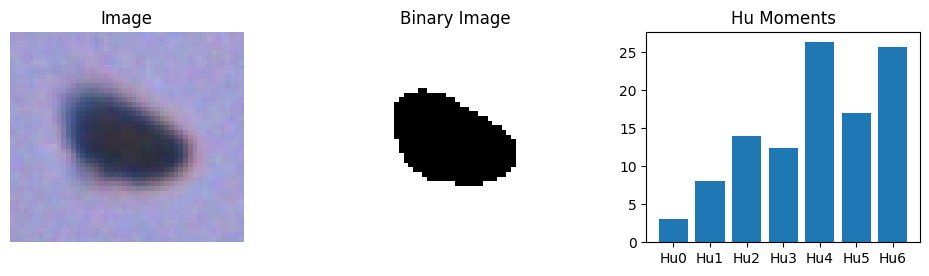

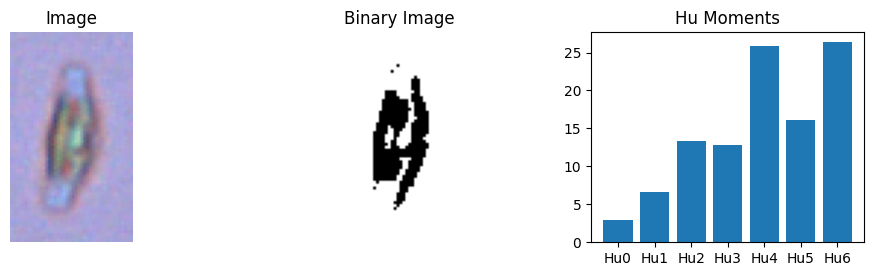

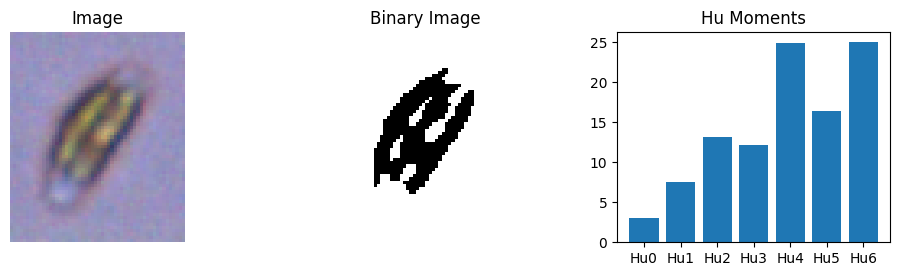

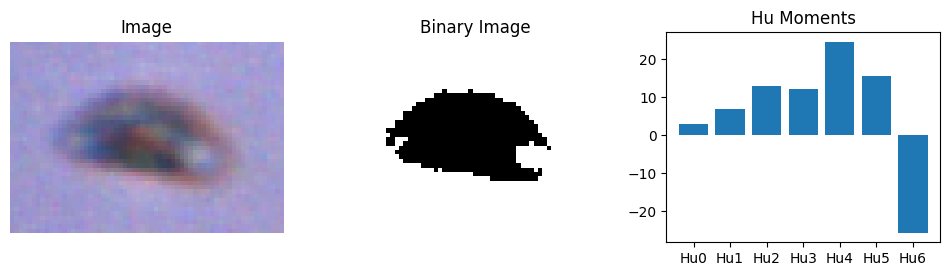

In [4]:
# Define the base directory where the images are stored
base_dir = 'data/ET22-05/ET-F/ET-F1 Final/split'

# Initialize a list or dictionary to store the Hu Moments for each image
hu_moments_all_images = {}

# Counter to limit the number of graphs
graph_count = 0

for index, row in df.iterrows():
    image_id = row['id']
    image_file_name = f'ET-F1 Final_{str(image_id).zfill(6)}.png'
    image_path = os.path.join(base_dir, image_file_name)
    
    image = cv2.imread(image_path)
    
    if image is not None:
        # Calculate Hu Moments for the ROI
        gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        _, binary_image = cv2.threshold(gray_image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
        moments = cv2.moments(binary_image)
        huMoments = cv2.HuMoments(moments)
        huMoments = -np.sign(huMoments) * np.log10(np.abs(huMoments))

        # Store the Hu Moments for all images
        hu_moments_all_images[image_id] = huMoments.flatten()

        if graph_count < 4:
            # Display the image and its Hu moments for the first 4 images
            plt.figure(figsize=(12, 6))

            plt.subplot(2, 3, 1)
            plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
            plt.title('Image')
            plt.axis('off')

            plt.subplot(2, 3, 2)
            plt.imshow(binary_image, cmap='gray')
            plt.title('Binary Image')
            plt.axis('off')

            plt.subplot(2, 3, 3)
            # Use all 7 Hu moments for the bar plot
            plt.bar(range(7), huMoments.flatten())
            plt.title('Hu Moments')
            plt.xticks(range(7), ['Hu0', 'Hu1', 'Hu2', 'Hu3', 'Hu4', 'Hu5', 'Hu6'])

            plt.show()
            
            graph_count += 1
    else:
        print(f"Image not found or unable to load: {image_file_name}")


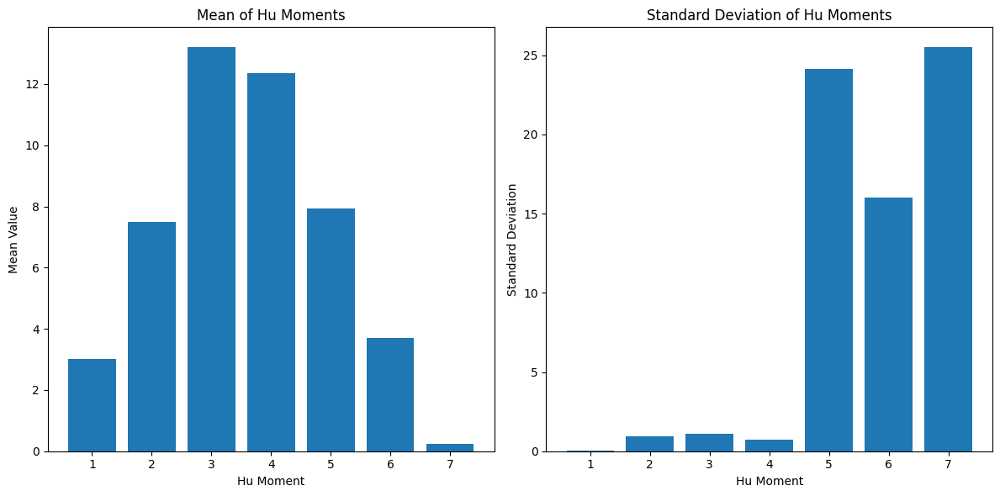

In [5]:
# Convert the Hu Moments dictionary to a numpy array for easier analysis
hu_moments_array = np.array(list(hu_moments_all_images.values()))

# Basic statistical analysis (mean and standard deviation for each Hu Moment)
means = np.mean(hu_moments_array, axis=0)
std_devs = np.std(hu_moments_array, axis=0)

# Plotting
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.bar(range(1, 8), means)
plt.title('Mean of Hu Moments')
plt.xlabel('Hu Moment')
plt.ylabel('Mean Value')

plt.subplot(1, 2, 2)
plt.bar(range(1, 8), std_devs)
plt.title('Standard Deviation of Hu Moments')
plt.xlabel('Hu Moment')
plt.ylabel('Standard Deviation')

plt.tight_layout()
plt.show()

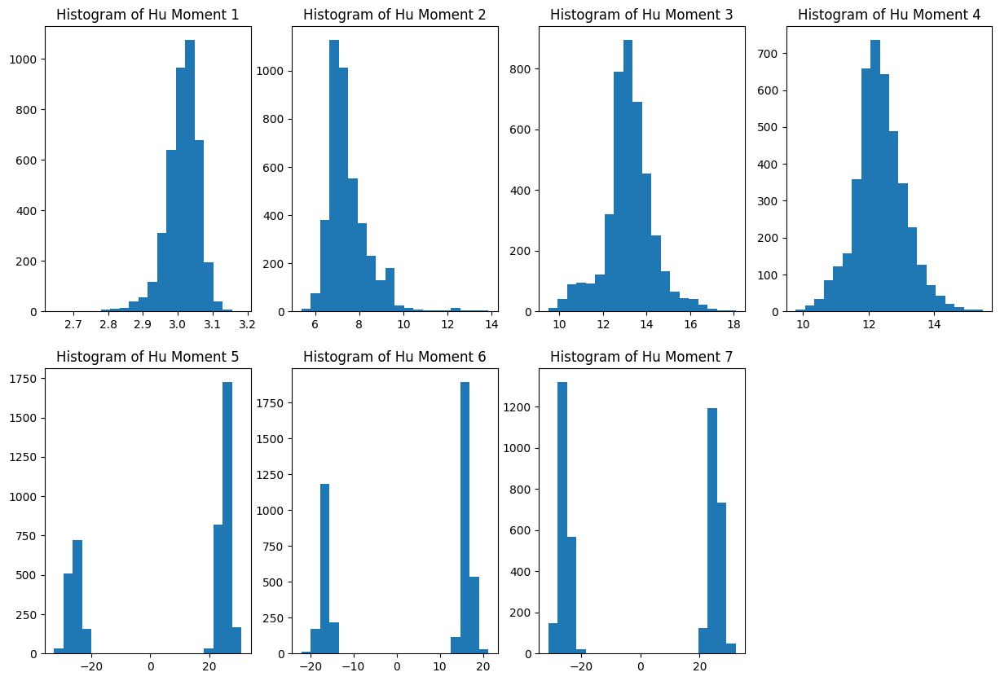

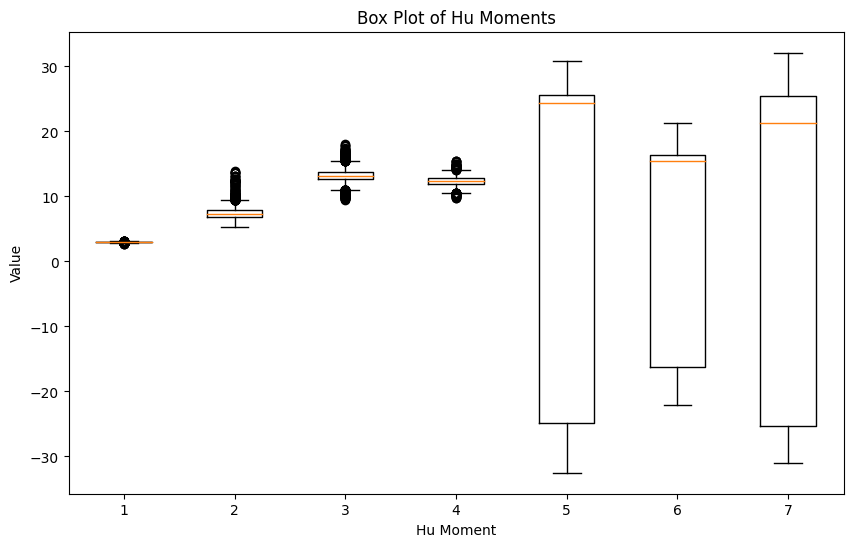

In [6]:
# Convert the Hu Moments dictionary to a numpy array for easier analysis
hu_moments_array = np.array(list(hu_moments_all_images.values()))

# Plot histograms for each Hu Moment
plt.figure(figsize=(15, 10))
for i in range(7):
    plt.subplot(2, 4, i+1)
    plt.hist(hu_moments_array[:, i], bins=20)
    plt.title(f'Histogram of Hu Moment {i+1}')

# Plot box plots for each Hu Moment
plt.figure(figsize=(10, 6))
plt.boxplot(hu_moments_array)
plt.title('Box Plot of Hu Moments')
plt.xlabel('Hu Moment')
plt.ylabel('Value')
plt.show()

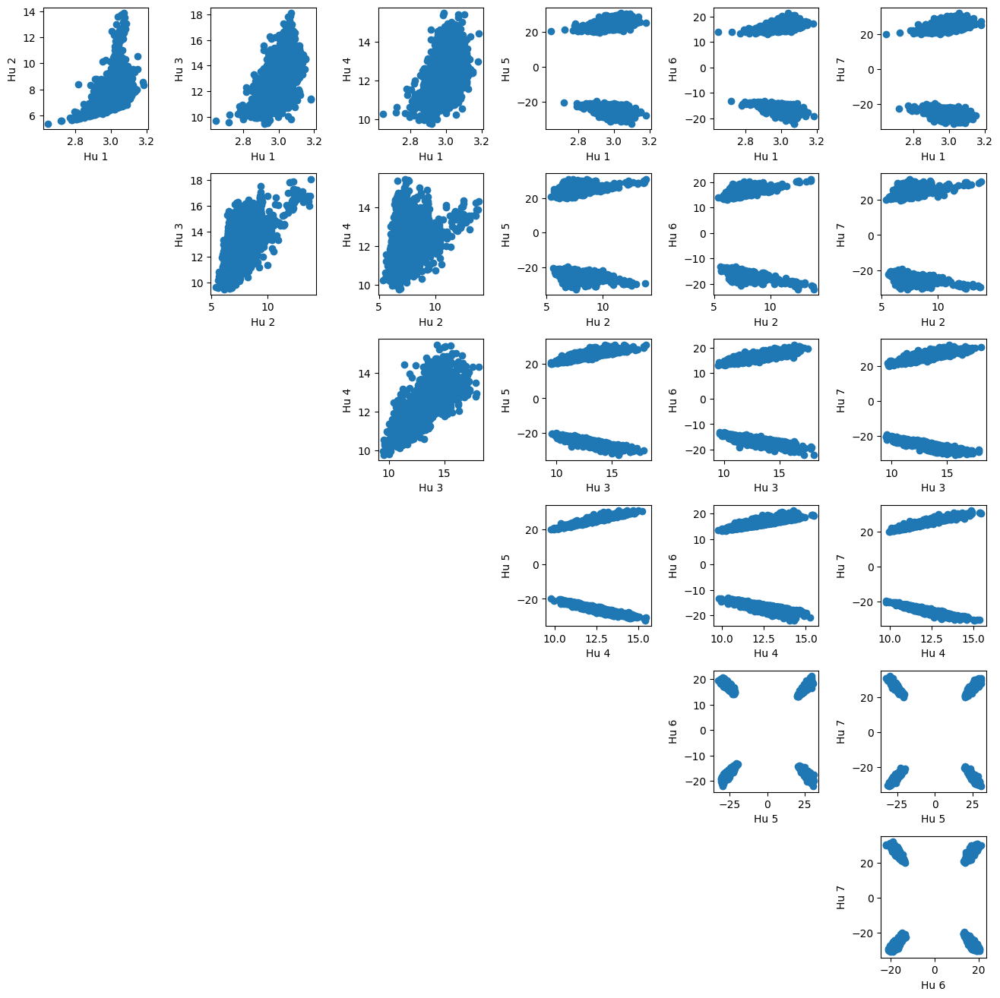

In [7]:
# Scatter plots to see the relationships between different Hu Moments
plt.figure(figsize=(15, 15))
for i in range(6):
    for j in range(i+1, 7):
        plt.subplot(7, 7, i*7+j+1)
        plt.scatter(hu_moments_array[:, i], hu_moments_array[:, j])
        plt.xlabel(f'Hu {i+1}')
        plt.ylabel(f'Hu {j+1}')
plt.tight_layout()
plt.show()

c:\Users\trist\miniconda3\envs\cv\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


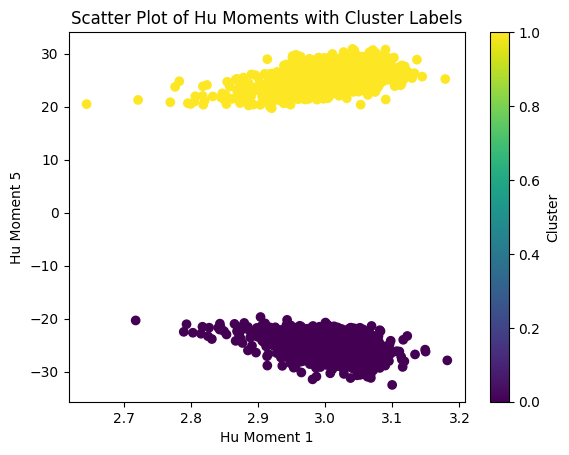

In [8]:
# Number of clusters
k = 2

# Perform K-Means clustering
kmeans = KMeans(n_clusters=k, random_state=0).fit(hu_moments_array)

# Get cluster labels
labels = kmeans.labels_

# Scatter plot of the first two Hu Moments colored by cluster
plt.scatter(hu_moments_array[:, 0], hu_moments_array[:, 4], c=labels)
plt.xlabel('Hu Moment 1')
plt.ylabel('Hu Moment 5')
plt.title('Scatter Plot of Hu Moments with Cluster Labels')
plt.colorbar(label='Cluster')
plt.show()



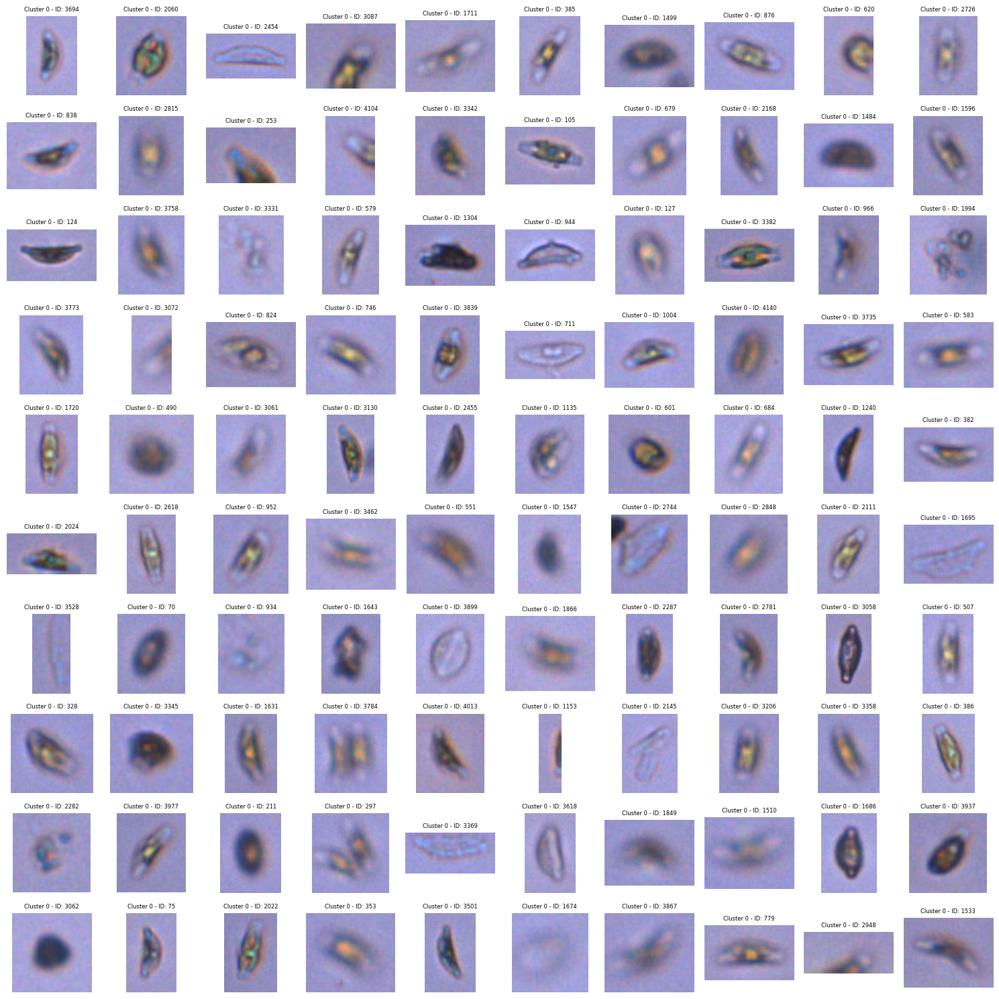

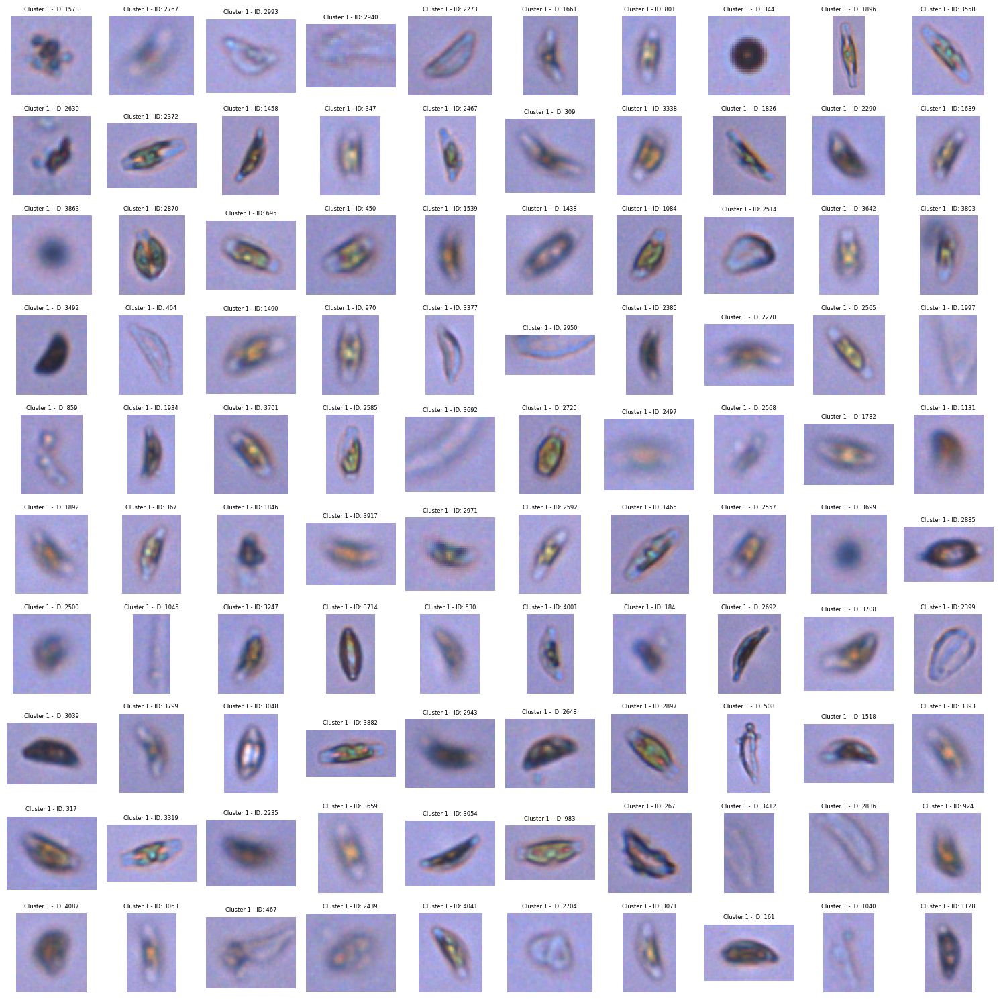

In [9]:
# Number of images to display from each cluster
num_images_to_display = 100  

# For the two-cluster scenario
# Get indices of images in Cluster 0 and Cluster 1
cluster_0_indices = np.where(labels == 0)[0]
cluster_1_indices = np.where(labels == 1)[0]

# Randomly select a subset of images from each cluster
random.shuffle(cluster_0_indices)
random.shuffle(cluster_1_indices)

# Create a large canvas to display the images
canvas_width = 10  # Number of images per row
canvas_height = 10  # Number of rows
fig, axes = plt.subplots(canvas_height, canvas_width, figsize=(15, 15))

# Display images from Cluster 0
for i in range(num_images_to_display):
    idx = cluster_0_indices[i]
    image_id = df.iloc[idx]['id']
    image_file_name = f'ET-F1 Final_{str(image_id).zfill(6)}.png'
    image_path = os.path.join(base_dir, image_file_name)
    image = cv2.imread(image_path)
    row = i // canvas_width
    col = i % canvas_width
    axes[row, col].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    axes[row, col].set_title(f'Cluster 0 - ID: {image_id}', fontsize=6)
    axes[row, col].axis('off')

# Ensure any empty subplots are removed
for i in range(num_images_to_display, canvas_width * canvas_height):
    row = i // canvas_width
    col = i % canvas_width
    fig.delaxes(axes[row, col])

plt.tight_layout()
plt.show()

# Create a large canvas to display the images
canvas_width = 10  # Number of images per row
canvas_height = 10  # Number of rows
fig, axes = plt.subplots(canvas_height, canvas_width, figsize=(15, 15))

#Display images from Cluster 1
for i in range(num_images_to_display):
    idx = cluster_1_indices[i]
    image_id = df.iloc[idx]['id']
    image_file_name = f'ET-F1 Final_{str(image_id).zfill(6)}.png'
    image_path = os.path.join(base_dir, image_file_name)
    image = cv2.imread(image_path)
    row = i // canvas_width
    col = i % canvas_width
    axes[row, col].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    axes[row, col].set_title(f'Cluster 1 - ID: {image_id}', fontsize=6)
    axes[row, col].axis('off')

# Ensure any empty subplots are removed
for i in range(num_images_to_display, canvas_width * canvas_height):
    row = i // canvas_width
    col = i % canvas_width
    fig.delaxes(axes[row, col])

plt.tight_layout()
plt.show()


c:\Users\trist\miniconda3\envs\cv\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


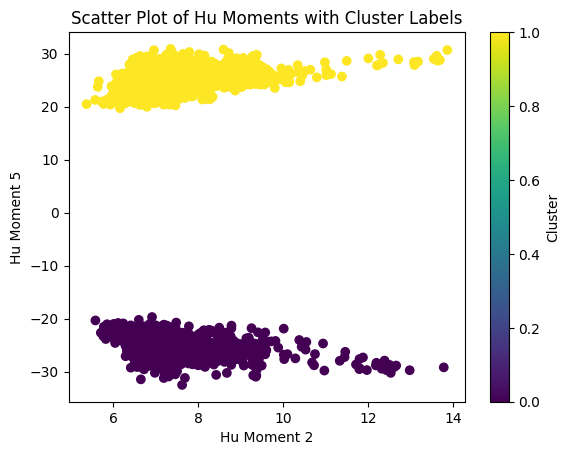

In [10]:
# Number of clusters
k = 2

# Perform K-Means clustering
kmeans = KMeans(n_clusters=k, random_state=0).fit(hu_moments_array)

# Get cluster labels
labels = kmeans.labels_

# Scatter plot of the first two Hu Moments colored by cluster
plt.scatter(hu_moments_array[:, 1], hu_moments_array[:, 4], c=labels)
plt.xlabel('Hu Moment 2')
plt.ylabel('Hu Moment 5')
plt.title('Scatter Plot of Hu Moments with Cluster Labels')
plt.colorbar(label='Cluster')
plt.show()



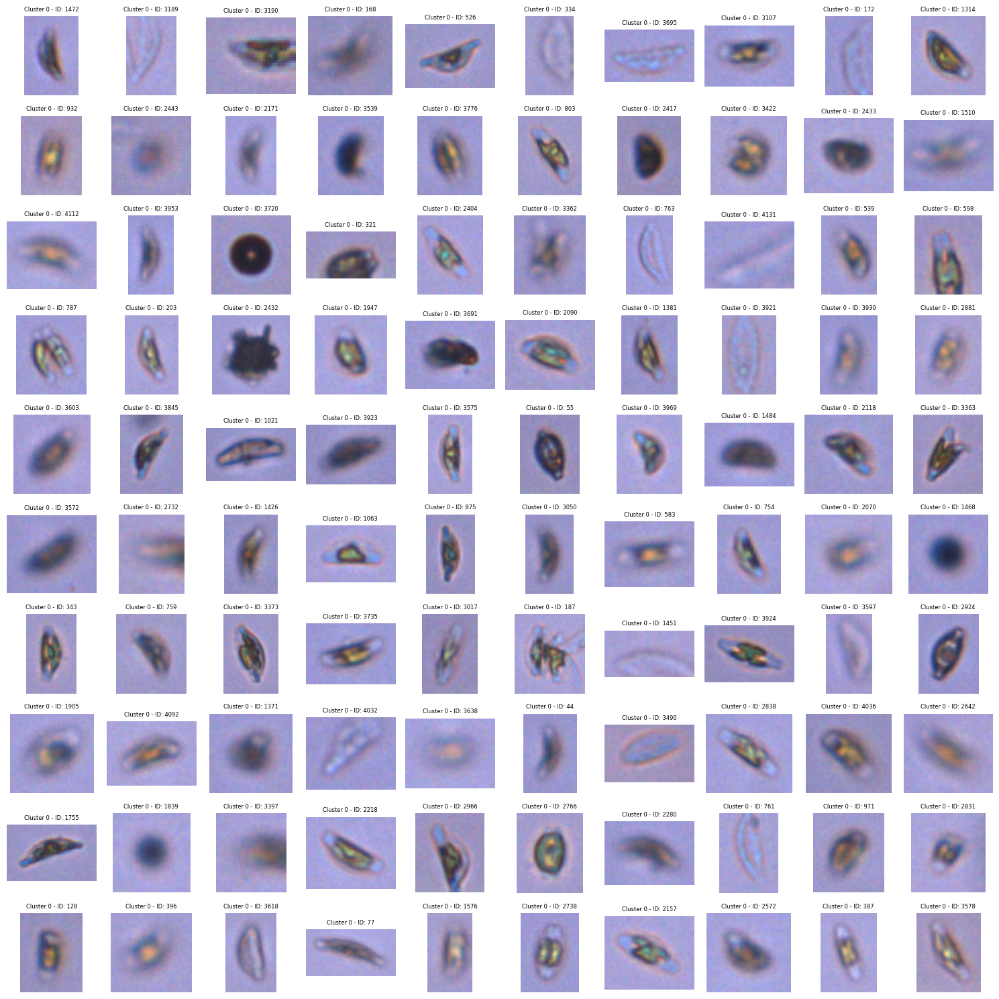

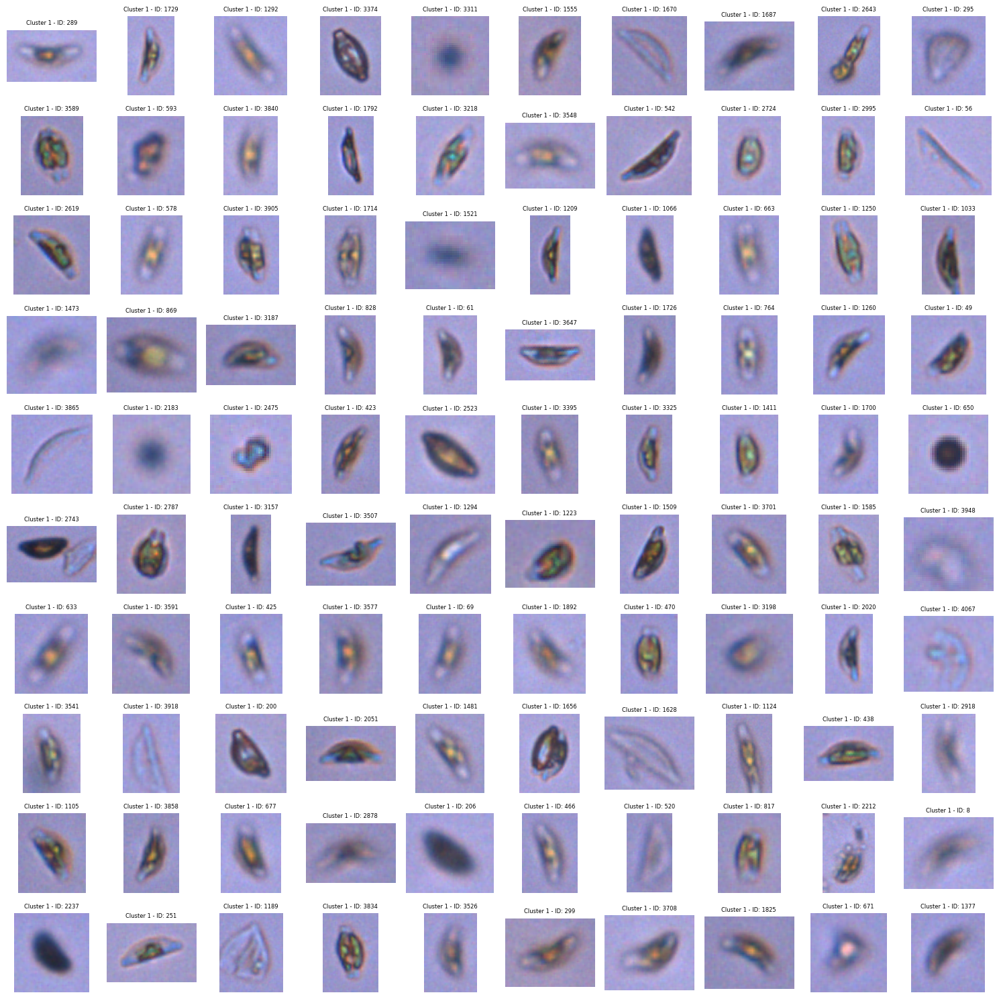

In [11]:
# Number of images to display from each cluster
num_images_to_display = 100

# For the two-cluster scenario
# Get indices of images in Cluster 0 and Cluster 1
cluster_0_indices = np.where(labels == 0)[0]
cluster_1_indices = np.where(labels == 1)[0]

# Randomly select a subset of images from each cluster
random.shuffle(cluster_0_indices)
random.shuffle(cluster_1_indices)

# Create a large canvas to display the images
canvas_width = 10  # Number of images per row
canvas_height = 10  # Number of rows
fig, axes = plt.subplots(canvas_height, canvas_width, figsize=(15, 15))

# Display images from Cluster 0
for i in range(num_images_to_display):
    idx = cluster_0_indices[i]
    image_id = df.iloc[idx]['id']
    image_file_name = f'ET-F1 Final_{str(image_id).zfill(6)}.png'
    image_path = os.path.join(base_dir, image_file_name)
    image = cv2.imread(image_path)
    row = i // canvas_width
    col = i % canvas_width
    axes[row, col].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    axes[row, col].set_title(f'Cluster 0 - ID: {image_id}', fontsize=6)
    axes[row, col].axis('off')

# Ensure any empty subplots are removed
for i in range(num_images_to_display, canvas_width * canvas_height):
    row = i // canvas_width
    col = i % canvas_width
    fig.delaxes(axes[row, col])

plt.tight_layout()
plt.show()

# Create a large canvas to display the images
canvas_width = 10  # Number of images per row
canvas_height = 10  # Number of rows
fig, axes = plt.subplots(canvas_height, canvas_width, figsize=(15, 15))

#Display images from Cluster 1
for i in range(num_images_to_display):
    idx = cluster_1_indices[i]
    image_id = df.iloc[idx]['id']
    image_file_name = f'ET-F1 Final_{str(image_id).zfill(6)}.png'
    image_path = os.path.join(base_dir, image_file_name)
    image = cv2.imread(image_path)
    row = i // canvas_width
    col = i % canvas_width
    axes[row, col].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    axes[row, col].set_title(f'Cluster 1 - ID: {image_id}', fontsize=6)
    axes[row, col].axis('off')

# Ensure any empty subplots are removed
for i in range(num_images_to_display, canvas_width * canvas_height):
    row = i // canvas_width
    col = i % canvas_width
    fig.delaxes(axes[row, col])

plt.tight_layout()
plt.show()


c:\Users\trist\miniconda3\envs\cv\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


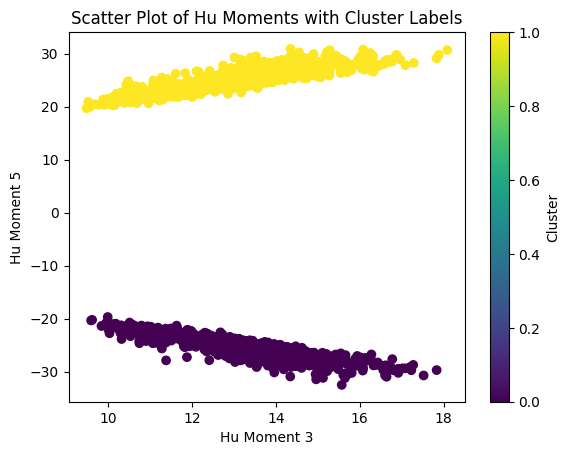

In [12]:
k = 2

# Perform K-Means clustering
kmeans = KMeans(n_clusters=k, random_state=0).fit(hu_moments_array)

# Get cluster labels
labels = kmeans.labels_

# Scatter plot of the first two Hu Moments colored by cluster
plt.scatter(hu_moments_array[:, 2], hu_moments_array[:, 4], c=labels)
plt.xlabel('Hu Moment 3')
plt.ylabel('Hu Moment 5')
plt.title('Scatter Plot of Hu Moments with Cluster Labels')
plt.colorbar(label='Cluster')
plt.show()



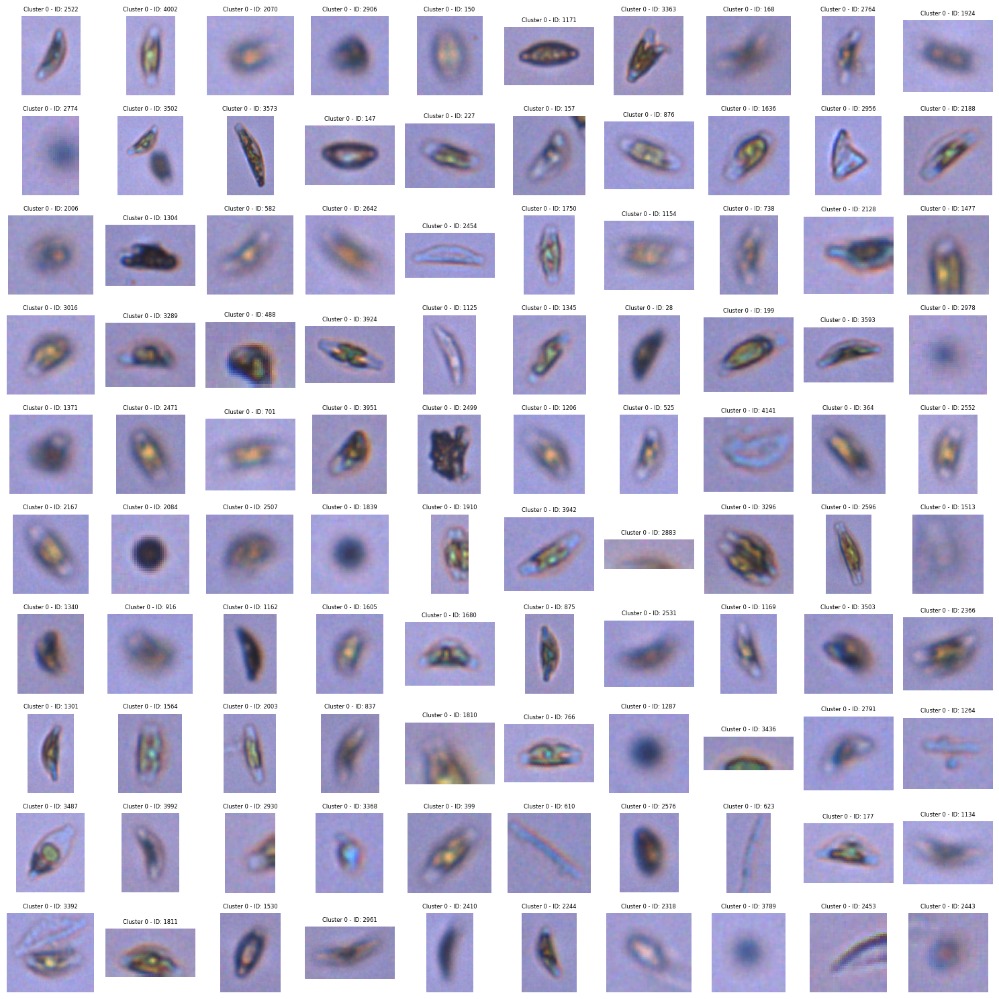

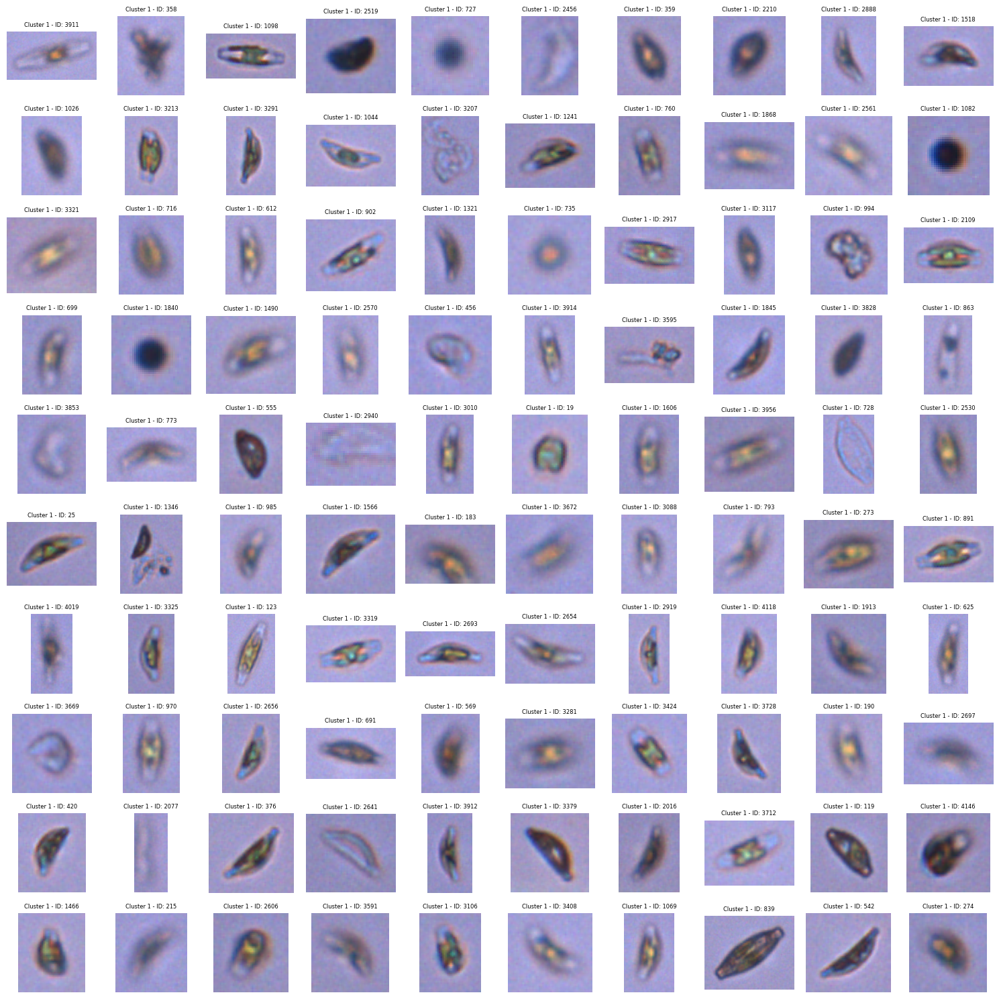

In [13]:
# Number of images to display from each cluster
num_images_to_display = 100

# For the two-cluster scenario
# Get indices of images in Cluster 0 and Cluster 1
cluster_0_indices = np.where(labels == 0)[0]
cluster_1_indices = np.where(labels == 1)[0]

# Randomly select a subset of images from each cluster
random.shuffle(cluster_0_indices)
random.shuffle(cluster_1_indices)

# Create a large canvas to display the images
canvas_width = 10  # Number of images per row
canvas_height = 10  # Number of rows
fig, axes = plt.subplots(canvas_height, canvas_width, figsize=(15, 15))

# Display images from Cluster 0
for i in range(num_images_to_display):
    idx = cluster_0_indices[i]
    image_id = df.iloc[idx]['id']
    image_file_name = f'ET-F1 Final_{str(image_id).zfill(6)}.png'
    image_path = os.path.join(base_dir, image_file_name)
    image = cv2.imread(image_path)
    row = i // canvas_width
    col = i % canvas_width
    axes[row, col].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    axes[row, col].set_title(f'Cluster 0 - ID: {image_id}', fontsize=6)
    axes[row, col].axis('off')

# Ensure any empty subplots are removed
for i in range(num_images_to_display, canvas_width * canvas_height):
    row = i // canvas_width
    col = i % canvas_width
    fig.delaxes(axes[row, col])

plt.tight_layout()
plt.show()

# Create a large canvas to display the images
canvas_width = 10  # Number of images per row
canvas_height = 10  # Number of rows
fig, axes = plt.subplots(canvas_height, canvas_width, figsize=(15, 15))

#Display images from Cluster 1
for i in range(num_images_to_display):
    idx = cluster_1_indices[i]
    image_id = df.iloc[idx]['id']
    image_file_name = f'ET-F1 Final_{str(image_id).zfill(6)}.png'
    image_path = os.path.join(base_dir, image_file_name)
    image = cv2.imread(image_path)
    row = i // canvas_width
    col = i % canvas_width
    axes[row, col].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    axes[row, col].set_title(f'Cluster 1 - ID: {image_id}', fontsize=6)
    axes[row, col].axis('off')

# Ensure any empty subplots are removed
for i in range(num_images_to_display, canvas_width * canvas_height):
    row = i // canvas_width
    col = i % canvas_width
    fig.delaxes(axes[row, col])

plt.tight_layout()
plt.show()


c:\Users\trist\miniconda3\envs\cv\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


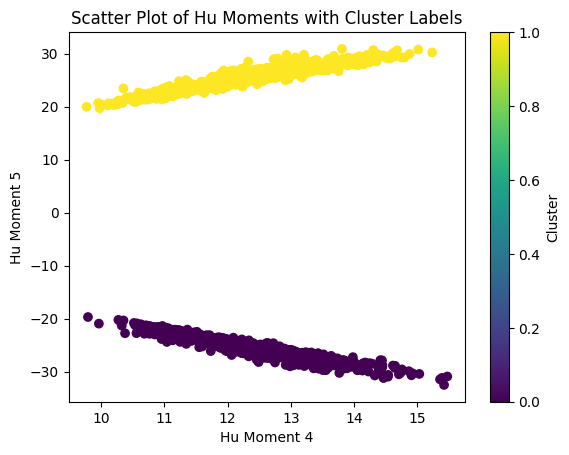

In [14]:
# Number of clusters
k = 2

# Perform K-Means clustering
kmeans = KMeans(n_clusters=k, random_state=0).fit(hu_moments_array)

# Get cluster labels
labels = kmeans.labels_

# Scatter plot of the first two Hu Moments colored by cluster
plt.scatter(hu_moments_array[:, 3], hu_moments_array[:, 4], c=labels)
plt.xlabel('Hu Moment 4')
plt.ylabel('Hu Moment 5')
plt.title('Scatter Plot of Hu Moments with Cluster Labels')
plt.colorbar(label='Cluster')
plt.show()



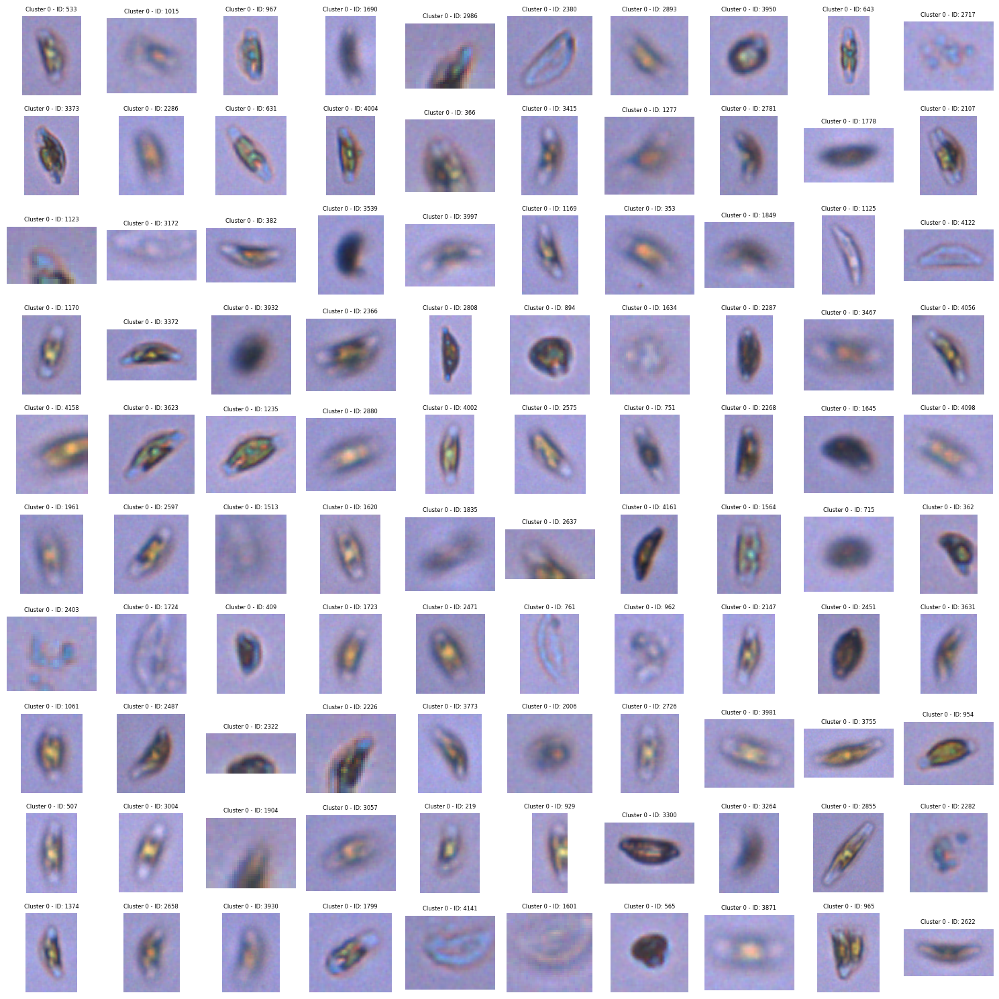

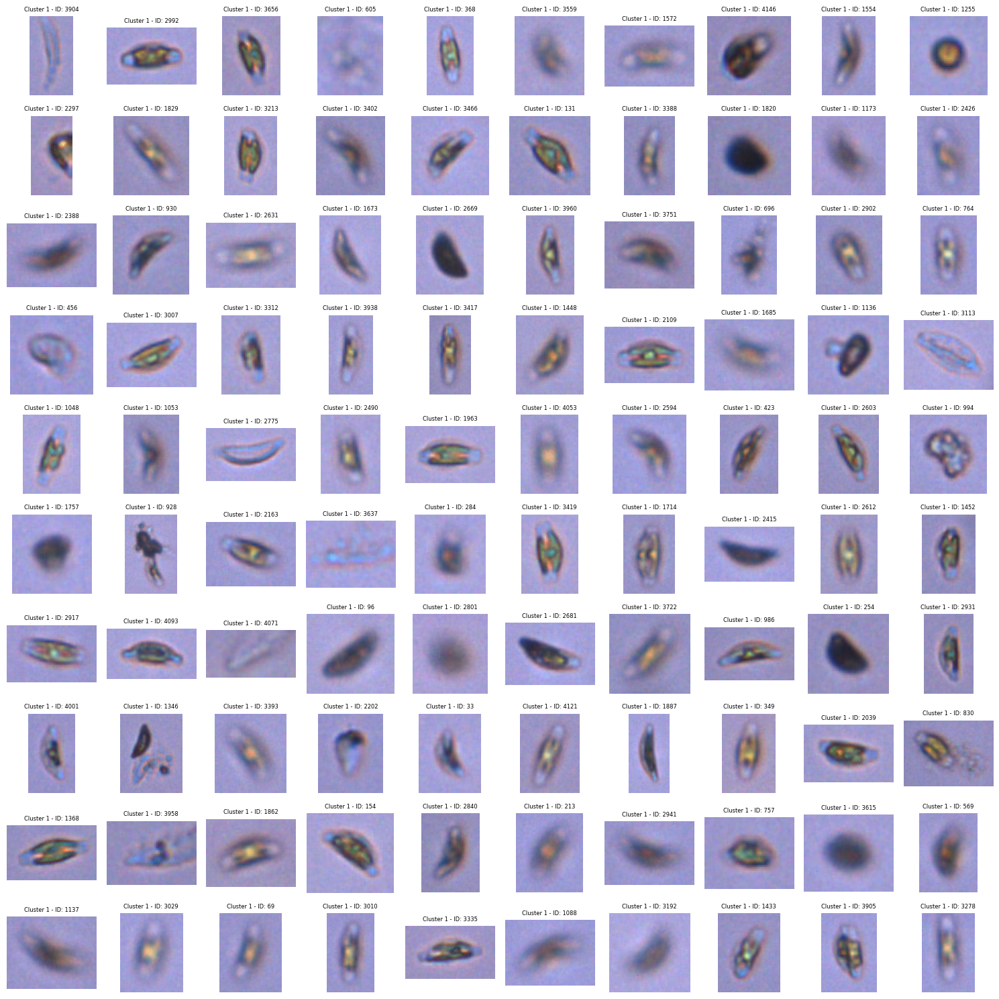

In [15]:
# Number of images to display from each cluster
num_images_to_display = 100

# For the two-cluster scenario
# Get indices of images in Cluster 0 and Cluster 1
cluster_0_indices = np.where(labels == 0)[0]
cluster_1_indices = np.where(labels == 1)[0]

# Randomly select a subset of images from each cluster
random.shuffle(cluster_0_indices)
random.shuffle(cluster_1_indices)

# Create a large canvas to display the images
canvas_width = 10  # Number of images per row
canvas_height = 10  # Number of rows
fig, axes = plt.subplots(canvas_height, canvas_width, figsize=(15, 15))

# Display images from Cluster 0
for i in range(num_images_to_display):
    idx = cluster_0_indices[i]
    image_id = df.iloc[idx]['id']
    image_file_name = f'ET-F1 Final_{str(image_id).zfill(6)}.png'
    image_path = os.path.join(base_dir, image_file_name)
    image = cv2.imread(image_path)
    row = i // canvas_width
    col = i % canvas_width
    axes[row, col].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    axes[row, col].set_title(f'Cluster 0 - ID: {image_id}', fontsize=6)
    axes[row, col].axis('off')

# Ensure any empty subplots are removed
for i in range(num_images_to_display, canvas_width * canvas_height):
    row = i // canvas_width
    col = i % canvas_width
    fig.delaxes(axes[row, col])

plt.tight_layout()
plt.show()

# Create a large canvas to display the images
canvas_width = 10  # Number of images per row
canvas_height = 10  # Number of rows
fig, axes = plt.subplots(canvas_height, canvas_width, figsize=(15, 15))

#Display images from Cluster 1
for i in range(num_images_to_display):
    idx = cluster_1_indices[i]
    image_id = df.iloc[idx]['id']
    image_file_name = f'ET-F1 Final_{str(image_id).zfill(6)}.png'
    image_path = os.path.join(base_dir, image_file_name)
    image = cv2.imread(image_path)
    row = i // canvas_width
    col = i % canvas_width
    axes[row, col].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    axes[row, col].set_title(f'Cluster 1 - ID: {image_id}', fontsize=6)
    axes[row, col].axis('off')

# Ensure any empty subplots are removed
for i in range(num_images_to_display, canvas_width * canvas_height):
    row = i // canvas_width
    col = i % canvas_width
    fig.delaxes(axes[row, col])

plt.tight_layout()
plt.show()


c:\Users\trist\miniconda3\envs\cv\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


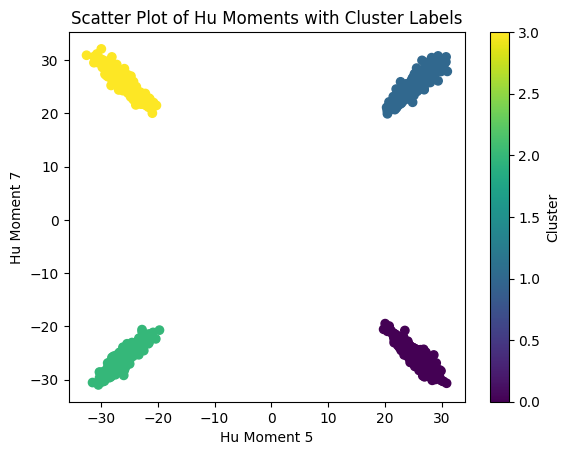

In [16]:
# Number of clusters
k = 4

# Perform K-Means clustering
kmeans = KMeans(n_clusters=k, random_state=0).fit(hu_moments_array)

# Get cluster labels
labels = kmeans.labels_

# Scatter plot of the first two Hu Moments colored by cluster
plt.scatter(hu_moments_array[:, 4], hu_moments_array[:, 6], c=labels)
plt.xlabel('Hu Moment 5')
plt.ylabel('Hu Moment 7')
plt.title('Scatter Plot of Hu Moments with Cluster Labels')
plt.colorbar(label='Cluster')
plt.show()



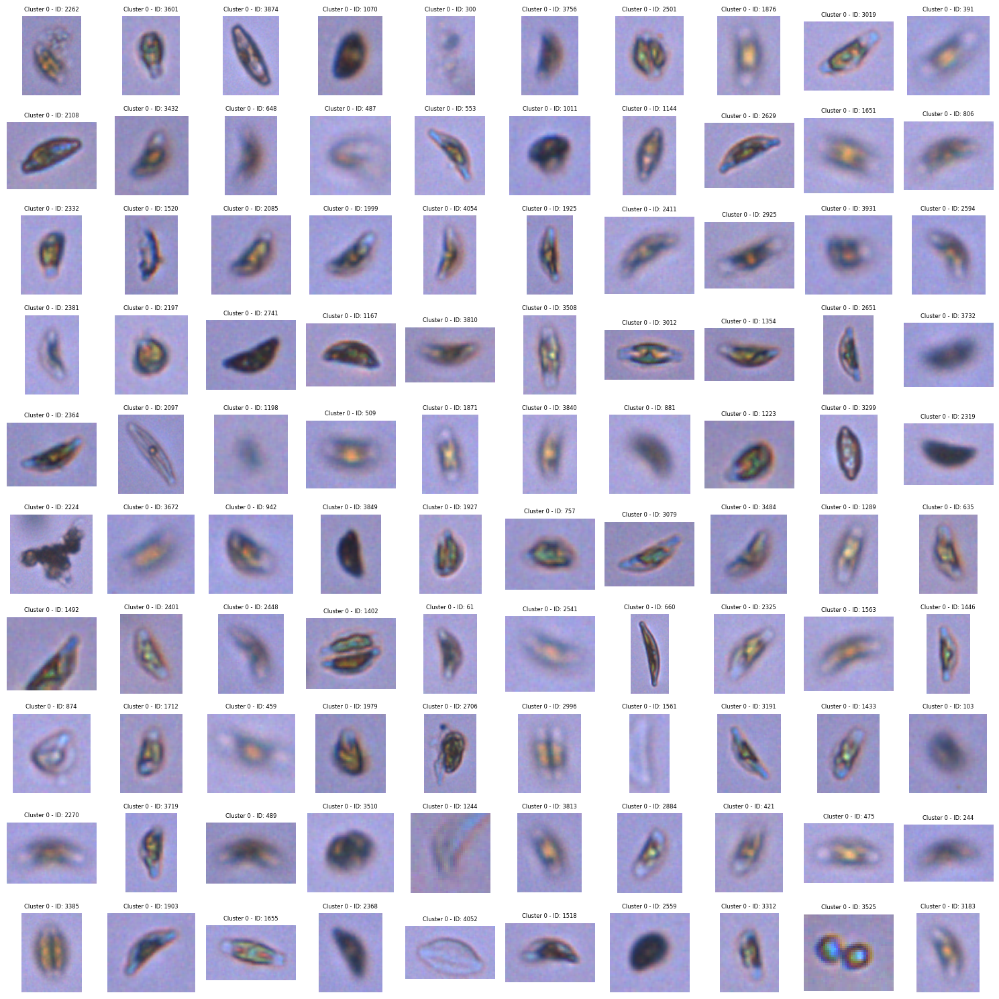

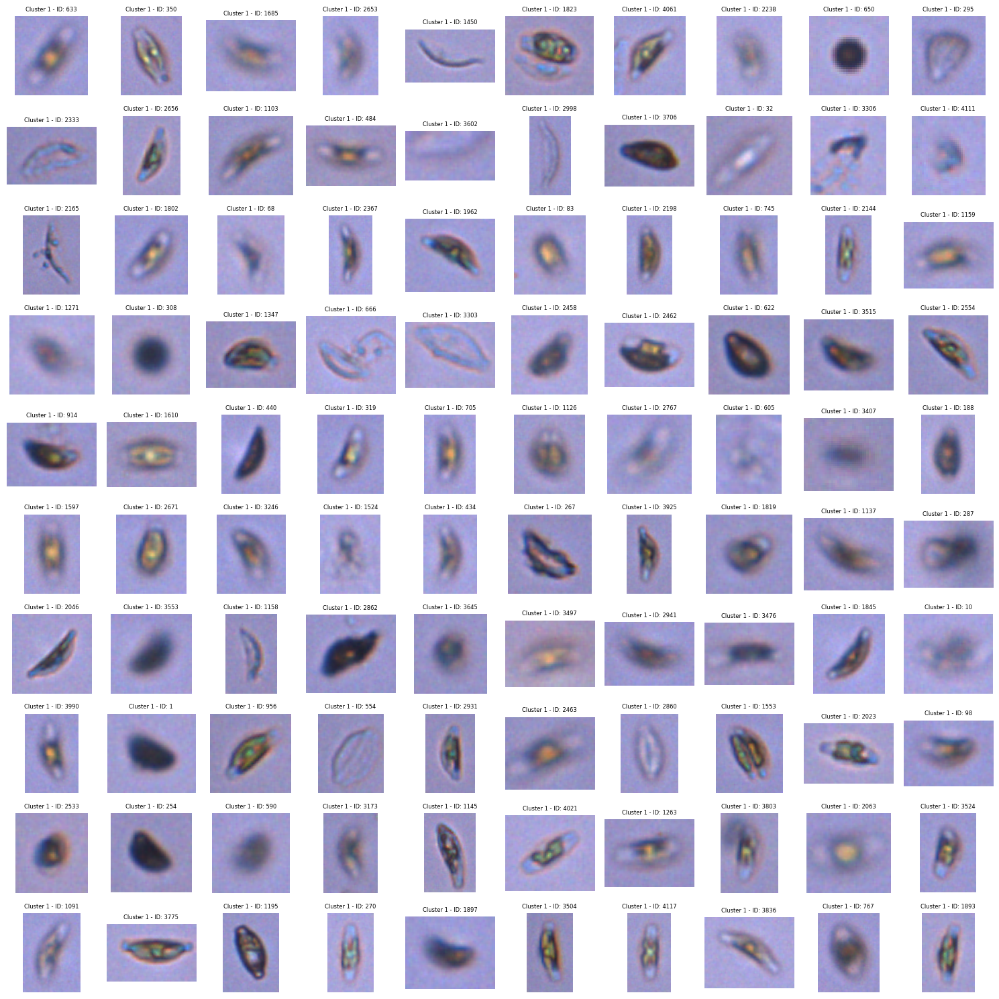

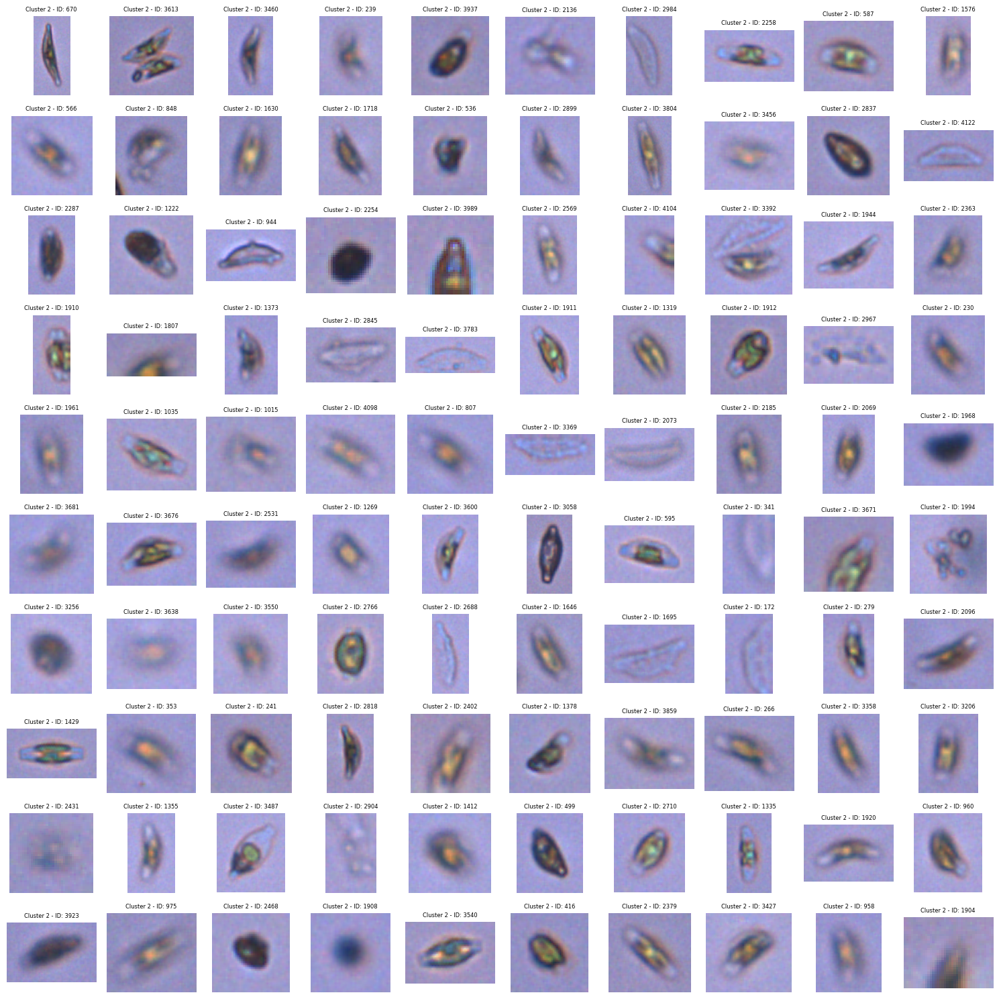

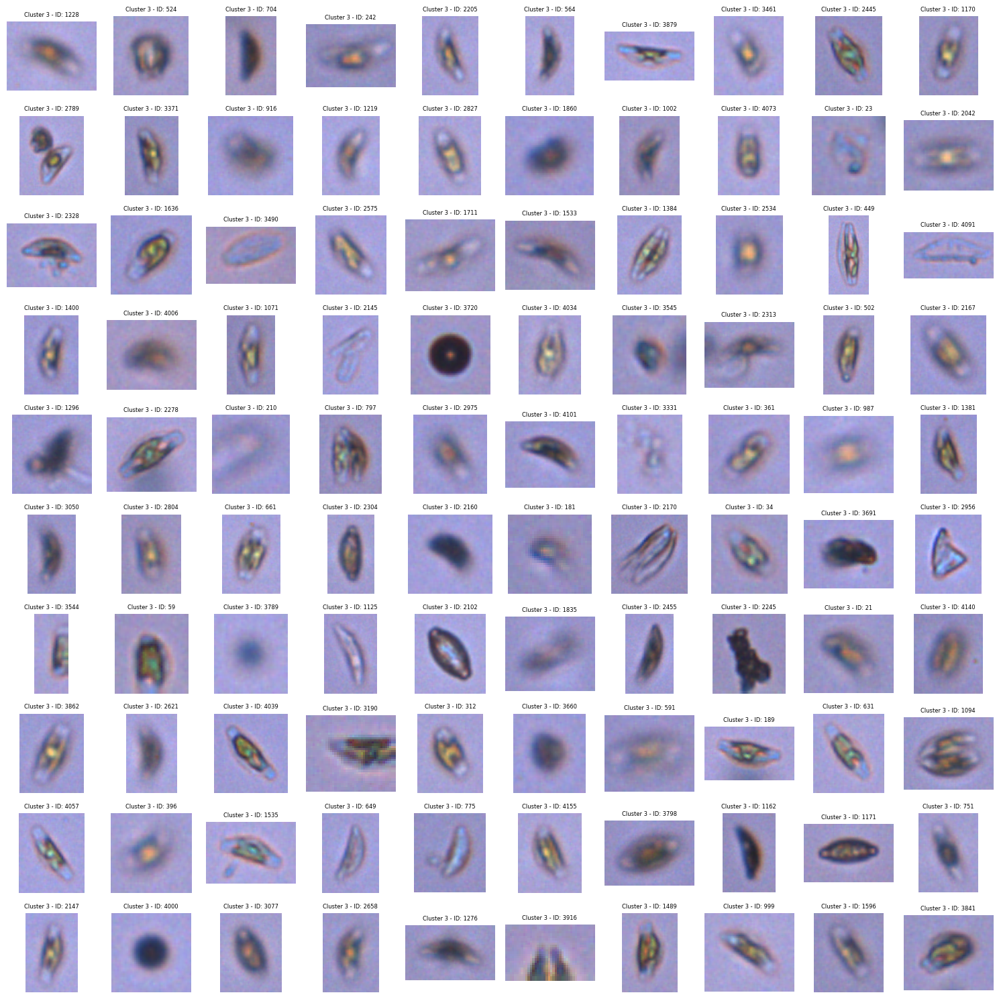

In [17]:
# Number of images to display from each cluster
num_images_to_display = 100

# Get the unique cluster labels
unique_labels = np.unique(labels)

# Display images for each cluster
for cluster_label in unique_labels:
    # Get indices of images in the current cluster
    cluster_indices = np.where(labels == cluster_label)[0]
    
    # Randomly select 100 images from the current cluster
    random.shuffle(cluster_indices)
    cluster_indices = cluster_indices[:num_images_to_display]
    
    # Create a figure for the current cluster
    fig, axes = plt.subplots(10, 10, figsize=(15, 15))
    
    # Display images from the current cluster
    for i, idx in enumerate(cluster_indices):
        image_id = df.iloc[idx]['id']
        image_file_name = f'ET-F1 Final_{str(image_id).zfill(6)}.png'
        image_path = os.path.join(base_dir, image_file_name)
        image = cv2.imread(image_path)
        row = i // 10
        col = i % 10
        axes[row, col].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        axes[row, col].set_title(f'Cluster {cluster_label} - ID: {image_id}', fontsize=6)
        axes[row, col].axis('off')
    
    plt.tight_layout()
    plt.show()
